# Mount Drive

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


# Importing Libraries

In [ ]:
import os
import random
import shutil
import glob
from IPython.display import Image, display
import cv2
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import torch

# Dataset Details

In [ ]:
import os

# The folder path
folder_path = '/content/drive/MyDrive/7thSemProject/PARU_Dataset_KIIT'
files = os.listdir(folder_path)

for file in files:
    print(file)

train
valid
test
S3R2-data.yml


In [ ]:
import os

# The paths for train, valid, and test directories
base_dir = '/content/drive/MyDrive/7thSemProject/PARU_Dataset_KIIT'
dirs = ['train', 'valid', 'test']

for dir_name in dirs:
    dir_path = os.path.join(base_dir, dir_name)
    print(f"\nDirectory: {dir_name}")
    for subfolder in os.listdir(dir_path):
        subfolder_path = os.path.join(dir_path, subfolder)

        if os.path.isdir(subfolder_path):
            num_files = len([f for f in os.listdir(subfolder_path) if os.path.isfile(os.path.join(subfolder_path, f))])
            print(f"  Subfolder: {subfolder}, Number of files: {num_files}")



Directory: train
  Subfolder: images, Number of files: 678
  Subfolder: labels, Number of files: 678

Directory: valid
  Subfolder: images, Number of files: 84
  Subfolder: labels, Number of files: 84

Directory: test
  Subfolder: images, Number of files: 86
  Subfolder: labels, Number of files: 86


We need to change yml file path (ex. train: drive/MyDrive/MLR/S3R2-KIIT/train/images) information according to which location we stored the dataset in our drive.

In [ ]:
yaml_file_path = '/content/drive/MyDrive/7thSemProject/PARU_Dataset_KIIT/S3R2-data.yml'
with open(yaml_file_path, 'r') as file:
    yaml_content = file.read()

print(yaml_content)


names:
  - Military
  - Para-military
  - Non-military
nc: 3
train: /content/drive/MyDrive/7thSemProject/PARU_Dataset_KIIT/train/images
val: /content/drive/MyDrive/7thSemProject/PARU_Dataset_KIIT/valid/images
test: /content/drive/MyDrive/7thSemProject/PARU_Dataset_KIIT/test/images



Let's see the information of a annotation file...

In [ ]:
import os

label_dir = '/content/drive/MyDrive/7thSemProject/PARU_Dataset_KIIT/test/labels'
label_file = 'm_101.txt'

label_path = os.path.join(label_dir, label_file)

if not os.path.exists(label_path):
    print(f"Label file not found: {label_path}")
else:
    with open(label_path, 'r') as f:
        lines = f.readlines()

    print(f"Label file: {label_file}")
    for line in lines:
        class_id, x_center, y_center, width, height = map(float, line.strip().split())

        print(f"Class ID: {int(class_id)}")
        print(f"Bounding Box: x_center={x_center}, y_center={y_center}, width={width}, height={height}")
        print("-" * 50)

Label file: m_101.txt
Class ID: 0
Bounding Box: x_center=0.41476, y_center=0.523353, width=0.767019, height=0.830697
--------------------------------------------------


In [ ]:
# Class names as per our dataset
class_names = [
    "Military",
  "Para-military",
  "Non-military"
]

# Visualization

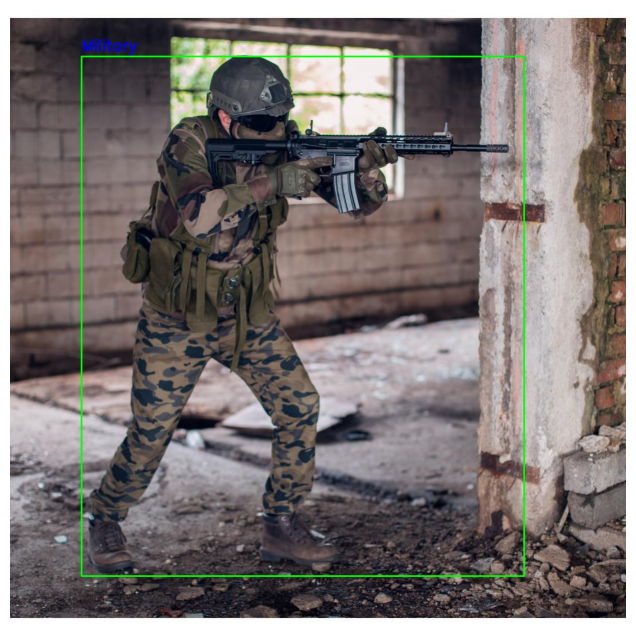

In [ ]:
import os
import cv2
import matplotlib.pyplot as plt


image_dir = '/content/drive/MyDrive/7thSemProject/PARU_Dataset_KIIT/test/images'
annotation_dir = '/content/drive/MyDrive/7thSemProject/PARU_Dataset_KIIT/test/labels'

def visualize_image_with_annotations(image_name):
    image_path = os.path.join(image_dir, image_name)
    img = cv2.imread(image_path)

    if img is None:
        print(f"Image not found: {image_path}")
        return

    annotation_name = os.path.splitext(image_name)[0] + '.txt'
    annotation_path = os.path.join(annotation_dir, annotation_name)

    if not os.path.exists(annotation_path):
        print(f"Annotation not found: {annotation_path}")
        return

    img_height, img_width = img.shape[:2]

    with open(annotation_path, 'r') as f:
        lines = f.readlines()

    for line in lines:
        # Parse values and convert class_id to integer
        class_id, x_center, y_center, width, height = map(float, line.strip().split())
        class_id = int(class_id)

        x_center = int(x_center * img_width)
        y_center = int(y_center * img_height)
        width = int(width * img_width)
        height = int(height * img_height)

        x_min = int(x_center - width / 2)
        y_min = int(y_center - height / 2)
        x_max = int(x_center + width / 2)
        y_max = int(y_center + height / 2)

        cv2.rectangle(img, (x_min, y_min), (x_max, y_max), color=(0, 255, 0), thickness=2)

        # Check if class_id is within bounds and retrieve class name
        if 0 <= class_id < len(class_names):
            class_name = class_names[class_id]
            cv2.putText(img, class_name, (x_min, y_min - 10), cv2.FONT_HERSHEY_SIMPLEX, 0.9, (255, 0, 0), 2)
        else:
            print(f"Class ID {class_id} is out of bounds for class names list.")

    img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

    plt.figure(figsize=(8, 8))
    plt.imshow(img_rgb)
    plt.axis('off')
    plt.show()

visualize_image_with_annotations('m_114.jpeg')


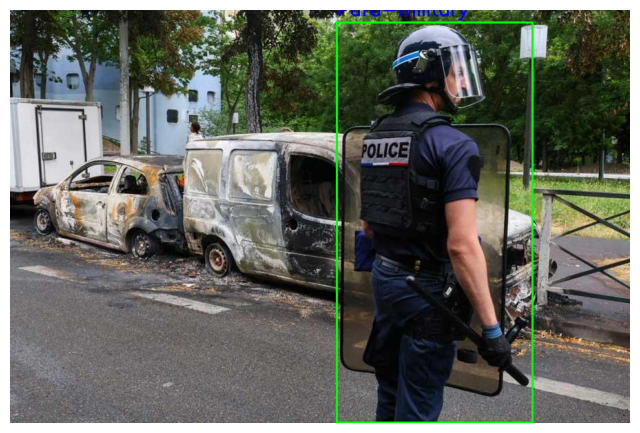

In [ ]:
visualize_image_with_annotations('p115.jpeg')

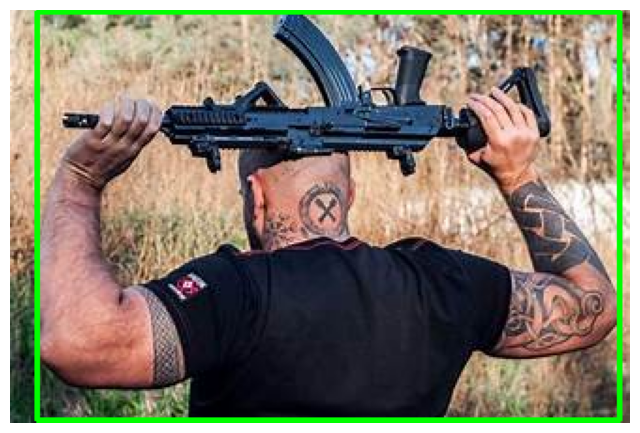

In [ ]:
visualize_image_with_annotations('n_155.jpeg')

# Cheking for GPU

In [ ]:
if torch.cuda.is_available():
    gpu_info = torch.cuda.get_device_properties(0)
    print(f"GPU is available: {gpu_info.name}")
    print(f"Total Memory: {gpu_info.total_memory / (1024**3):.2f} GB")
    print(f"CUDA Capability: {gpu_info.major}.{gpu_info.minor}")
else:
    print("GPU not available, running on CPU.")


GPU is available: Tesla T4
Total Memory: 14.75 GB
CUDA Capability: 7.5


In [ ]:
!nvidia-smi

Mon Jan  6 17:31:18 2025       
+---------------------------------------------------------------------------------------+
| NVIDIA-SMI 535.104.05             Driver Version: 535.104.05   CUDA Version: 12.2     |
|-----------------------------------------+----------------------+----------------------+
| GPU  Name                 Persistence-M | Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp   Perf          Pwr:Usage/Cap |         Memory-Usage | GPU-Util  Compute M. |
|                                         |                      |               MIG M. |
|=========================================+======================+======================|
|   0  Tesla T4                       Off | 00000000:00:04.0 Off |                    0 |
| N/A   31C    P8              11W /  70W |      3MiB / 15360MiB |      0%      Default |
|                                         |                      |                  N/A |
+-----------------------------------------+----------------------+--

# Setting up YOLOV11-SMALL...

In [ ]:
%pip install ultralytics supervision roboflow
import ultralytics
ultralytics.checks()

Ultralytics 8.3.58 🚀 Python-3.10.12 torch-2.5.1+cu121 CUDA:0 (Tesla T4, 15102MiB)
Setup complete ✅ (2 CPUs, 12.7 GB RAM, 32.7/112.6 GB disk)


Using the YOLOv8_SMALL model

In [ ]:
!yolo task=detect mode=train model=/content/yolo11s.pt data=/content/drive/MyDrive/7thSemProject/PARU_Dataset_KIIT/S3R2-data.yml epochs=100 imgsz=640 plots=True

100% 18.4M/18.4M [00:00<00:00, 121MB/s] 
Ultralytics 8.3.58 🚀 Python-3.10.12 torch-2.5.1+cu121 CUDA:0 (Tesla T4, 15102MiB)
engine/trainer: task=detect, mode=train, model=/content/yolo11s.pt, data=/content/drive/MyDrive/7thSemProject/PARU_Dataset_KIIT/S3R2-data.yml, epochs=100, time=None, patience=100, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=train, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, embed=None, show=False, save_frames=False, s

# Saving the result

In [ ]:
from google.colab import drive
import shutil

source_path = '/content/runs'
destination_path = '/content/drive/MyDrive/MLR/Yolo11Small_output'
shutil.copytree(source_path, destination_path)

print(f"The `runs` folder has been copied to: {destination_path}")

# Result Analysis

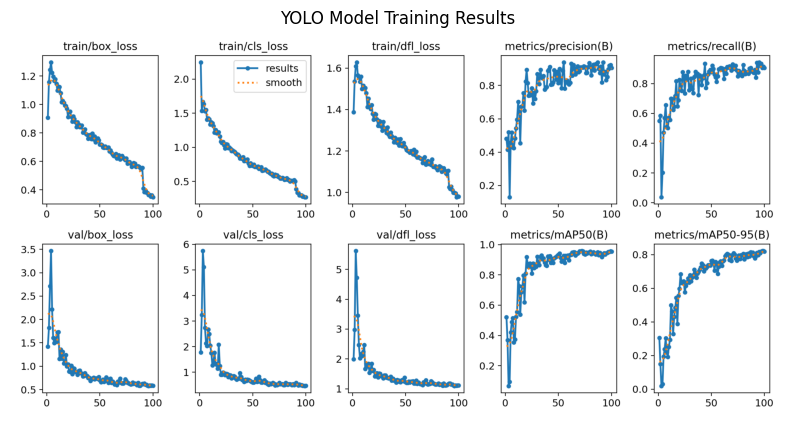

In [ ]:
import matplotlib.pyplot as plt
import matplotlib.image as mpimg

# Load and display the results image
results_image_path = '/content/runs/detect/train2/results.png'
img = mpimg.imread(results_image_path)

plt.figure(figsize=(10, 6))
plt.imshow(img)
plt.axis('off')
plt.title('YOLO Model Training Results')
plt.show()


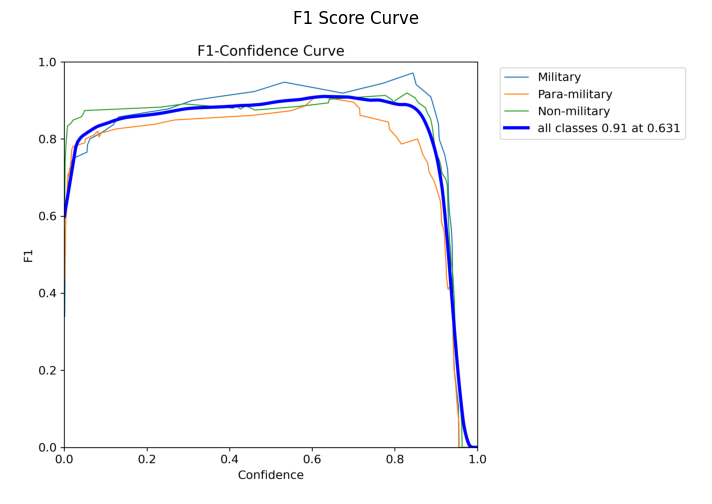

In [ ]:
import matplotlib.pyplot as plt
import matplotlib.image as mpimg

# Load and display the F1 curve image
f1_curve_path = '/content/runs/detect/train2/F1_curve.png'
img = mpimg.imread(f1_curve_path)

plt.figure(figsize=(10, 6))
plt.imshow(img)
plt.axis('off')
plt.title('F1 Score Curve')
plt.show()


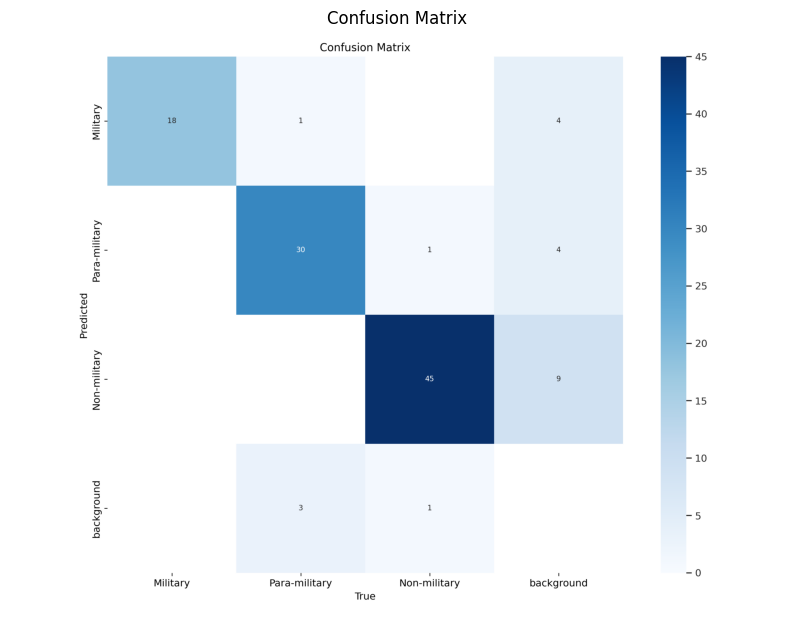

In [ ]:
import matplotlib.pyplot as plt
import matplotlib.image as mpimg

# Path to the confusion matrix image
image_path = '/content/runs/detect/train2/confusion_matrix.png'

# Read and display the image
img = mpimg.imread(image_path)
plt.figure(figsize=(10, 8))
plt.imshow(img)
plt.axis('off')
plt.title('Confusion Matrix')
plt.show()


# Detection

Single Image Detection

In [ ]:
# !yolo task=detect mode=predict model=/content/runs/detect/train/weights/best.pt conf=0.40 source=/content/drive/MyDrive/MLR/S3R2-KIIT/valid/images/image_s3r2_kiit_176.jpeg save=True
!yolo task=detect mode=predict model=/content/runs/detect/train2/weights/best.pt conf=0.50 source=/content/drive/MyDrive/7thSemProject/PARU_Dataset_KIIT/train/images/m_100.jpeg save=True

Ultralytics 8.3.27 🚀 Python-3.10.12 torch-2.5.0+cu121 CUDA:0 (Tesla T4, 15102MiB)
YOLO11s summary (fused): 238 layers, 9,413,961 parameters, 0 gradients, 21.3 GFLOPs

image 1/1 /content/drive/MyDrive/7thSemProject/PARU_Dataset_KIIT/train/images/m_100.jpeg: 640x640 1 Military, 16.1ms
Speed: 6.2ms preprocess, 16.1ms inference, 526.8ms postprocess per image at shape (1, 3, 640, 640)
Results saved to runs/detect/predict
💡 Learn more at https://docs.ultralytics.com/modes/predict


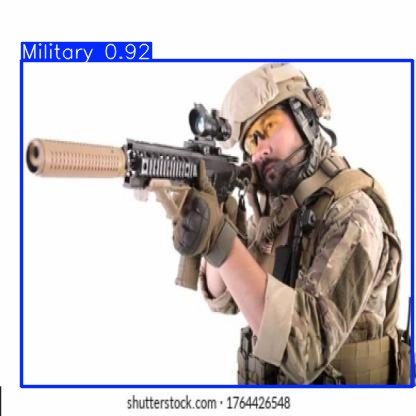

In [ ]:
#display inference on ALL test images

import glob
from IPython.display import Image, display

for imageName in glob.glob('/content/runs/detect/predict/m_100.jpg'): #assuming JPG
    display(Image(filename=imageName))
    print("\n")

Multiple Image detection

In [ ]:
# !yolo detect predict --weights /content/drive/MyDrive/MLR/S3R2-KIIT4/weights/best.pt --source /content/drive/MyDrive/MLR/test_images --img 640 --conf 0.25 --save-txt --save-conf --device 0
# !yolo detect predict model=/content/drive/MyDrive/MLR/S3R2-KIIT4/weights/best.pt source=/content/drive/MyDrive/MLR/test_images imgsz=640 conf=0.25 save_txt=True save_conf=True device=0
!yolo task=detect mode=predict model=/content/runs/detect/train2/weights/best.pt conf=0.40 iou=0.45 source=/content/drive/MyDrive/7thSemProject/new_test_images save=True save_txt=True

Ultralytics 8.3.27 🚀 Python-3.10.12 torch-2.5.0+cu121 CUDA:0 (Tesla T4, 15102MiB)
YOLO11s summary (fused): 238 layers, 9,413,961 parameters, 0 gradients, 21.3 GFLOPs

image 1/15 /content/drive/MyDrive/7thSemProject/new_test_images/images (28).jpeg: 448x640 1 Non-military, 51.2ms
image 2/15 /content/drive/MyDrive/7thSemProject/new_test_images/images (5).jpeg: 448x640 1 Non-military, 12.3ms
image 3/15 /content/drive/MyDrive/7thSemProject/new_test_images/m1.jpeg: 640x416 1 Military, 50.8ms
image 4/15 /content/drive/MyDrive/7thSemProject/new_test_images/m2.jpeg: 384x640 2 Militarys, 48.4ms
image 5/15 /content/drive/MyDrive/7thSemProject/new_test_images/m3.jpeg: 640x576 2 Militarys, 80.6ms
image 6/15 /content/drive/MyDrive/7thSemProject/new_test_images/m4.jpeg: 448x640 2 Militarys, 13.0ms
image 7/15 /content/drive/MyDrive/7thSemProject/new_test_images/m5.jpeg: 320x640 2 Militarys, 59.9ms
image 8/15 /content/drive/MyDrive/7thSemProject/new_test_images/p1.jpeg: 448x640 2 Para-militarys, 12.9m

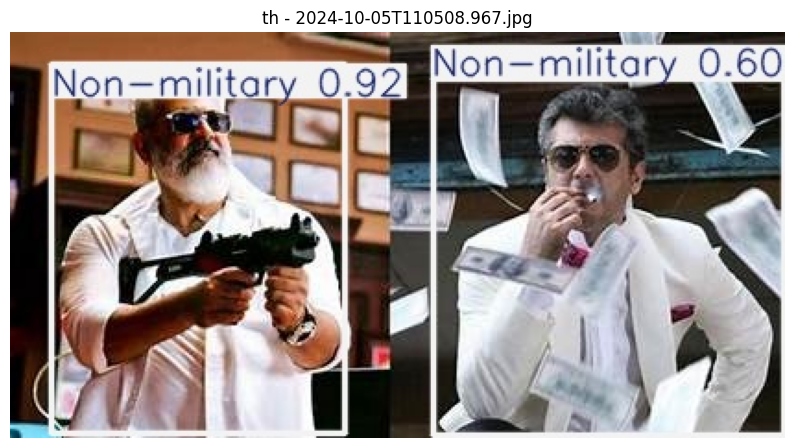

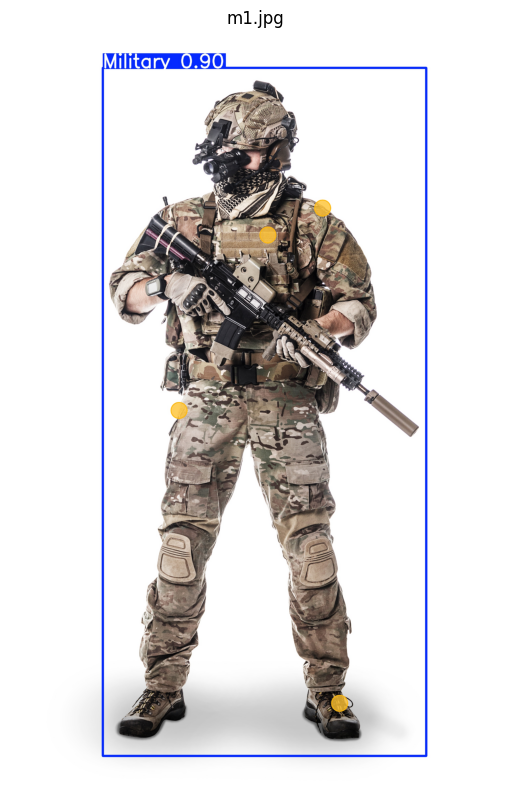

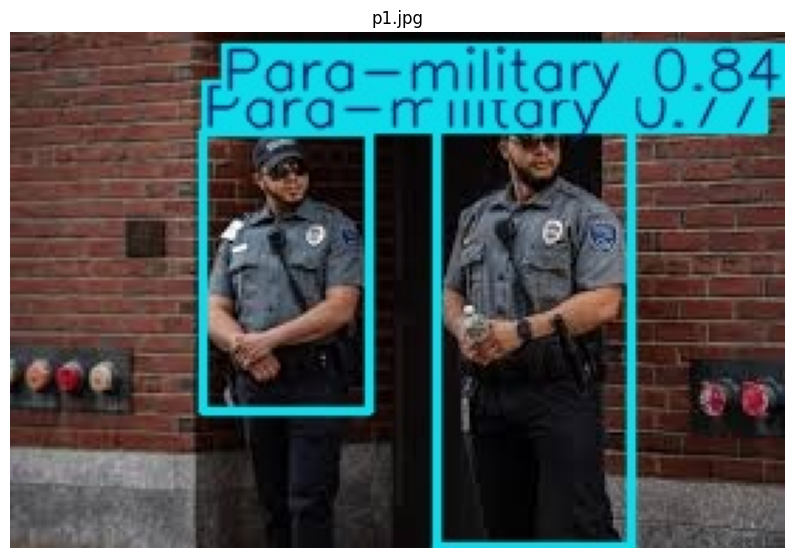

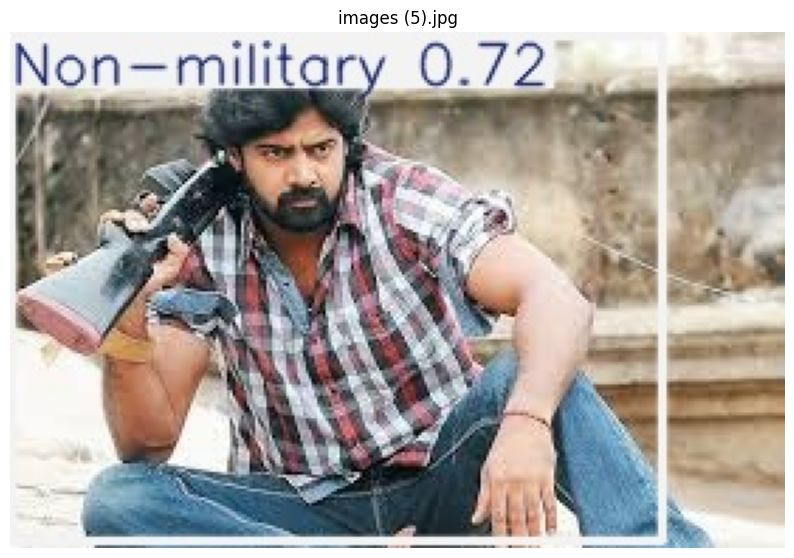

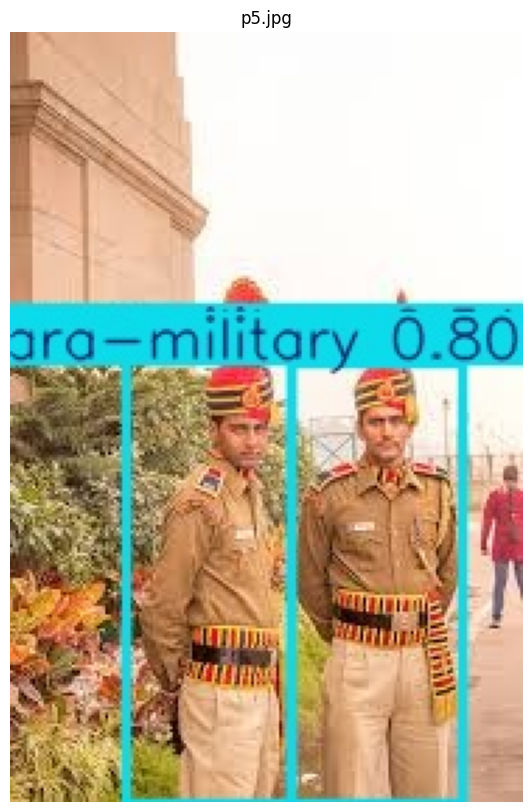

...

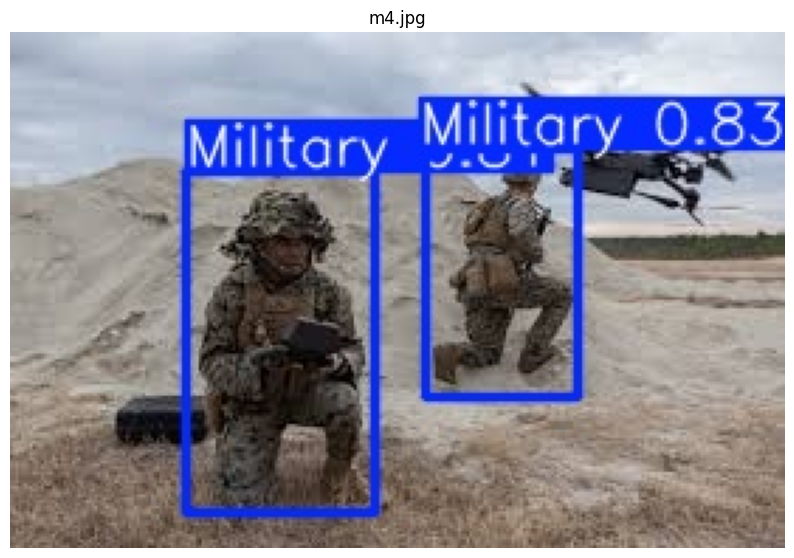

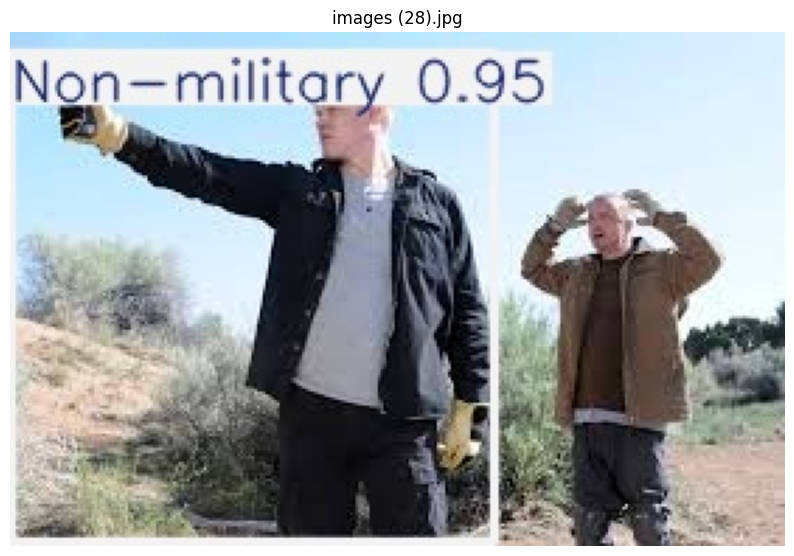

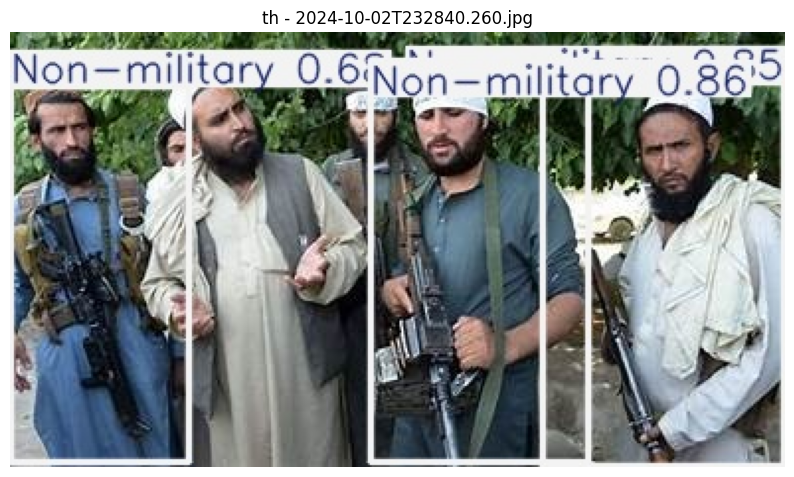

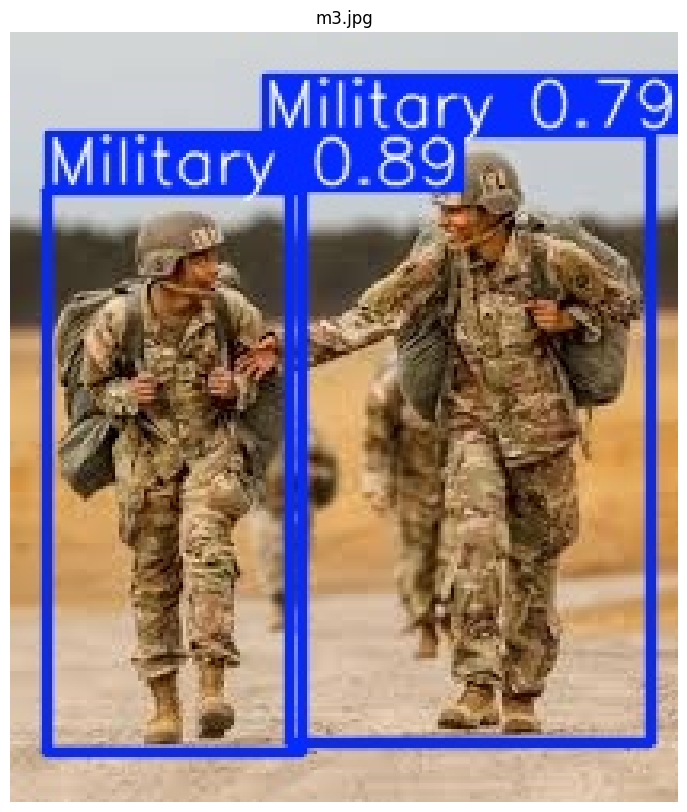

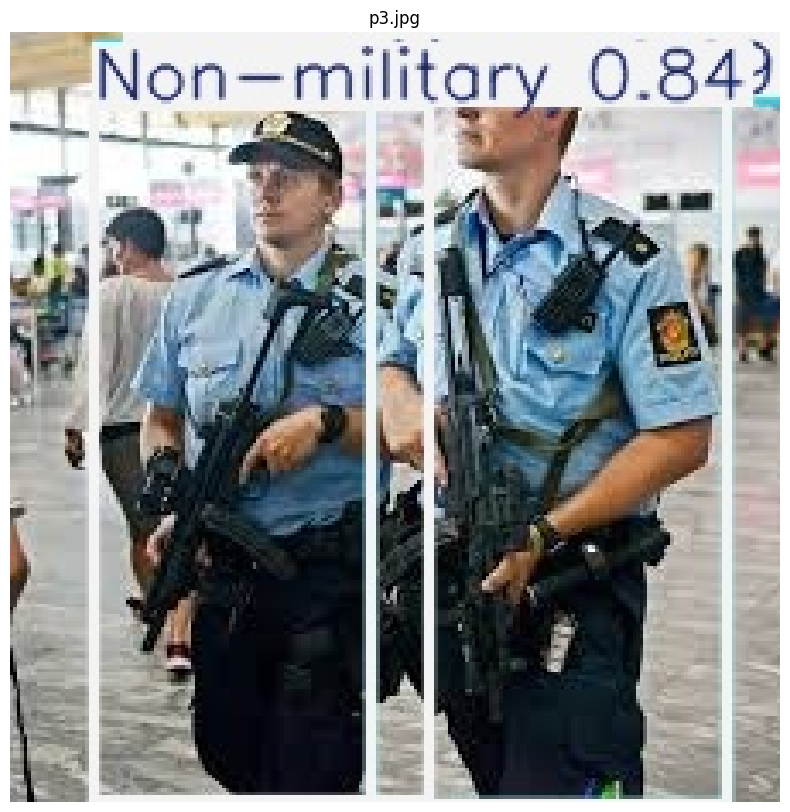

In [ ]:
import matplotlib.pyplot as plt
import cv2
import os

image_folder = 'runs/detect/predict2/'

image_files = [f for f in os.listdir(image_folder) if f.endswith(('.jpg', '.jpeg', '.webp'))]


for image_file in image_files:
    img_path = os.path.join(image_folder, image_file)
    img = cv2.imread(img_path)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

    plt.figure(figsize=(10, 10))
    plt.imshow(img)
    plt.title(image_file)
    plt.axis('off')
    plt.show()

In [ ]:
!yolo task=detect mode=predict model=/content/runs/detect/train2/weights/best.pt conf=0.40 iou=0.45 source=/content/drive/MyDrive/7thSemProject/test_images save=True save_txt=True

Ultralytics 8.3.27 🚀 Python-3.10.12 torch-2.5.0+cu121 CUDA:0 (Tesla T4, 15102MiB)
YOLO11s summary (fused): 238 layers, 9,413,961 parameters, 0 gradients, 21.3 GFLOPs

image 1/91 /content/drive/MyDrive/7thSemProject/test_images/1786_png_jpg.rf.45db940f94cc1b2545795d4bab187c95.jpeg: 640x640 (no detections), 15.9ms
image 2/91 /content/drive/MyDrive/7thSemProject/test_images/1831_png_jpg.rf.3dd5493f94cae732acbad97e61124b2f.jpeg: 640x640 1 Military, 15.7ms
image 3/91 /content/drive/MyDrive/7thSemProject/test_images/2751_png_jpg.rf.2c170fe49a74374ebbafb4f0b255a52e.jpeg: 640x640 (no detections), 15.7ms
image 4/91 /content/drive/MyDrive/7thSemProject/test_images/2768_png_jpg.rf.8f89ecc03d5df771c9994350bf493559.jpeg: 640x640 1 Military, 15.7ms
image 5/91 /content/drive/MyDrive/7thSemProject/test_images/810_png_jpg.rf.c61bf6ba28e3e3aefbae8e628fc0d02f.jpeg: 640x640 1 Military, 1 Non-military, 42.6ms
image 6/91 /content/drive/MyDrive/7thSemProject/test_images/92.jpeg: 640x640 1 Military, 15.7ms
im

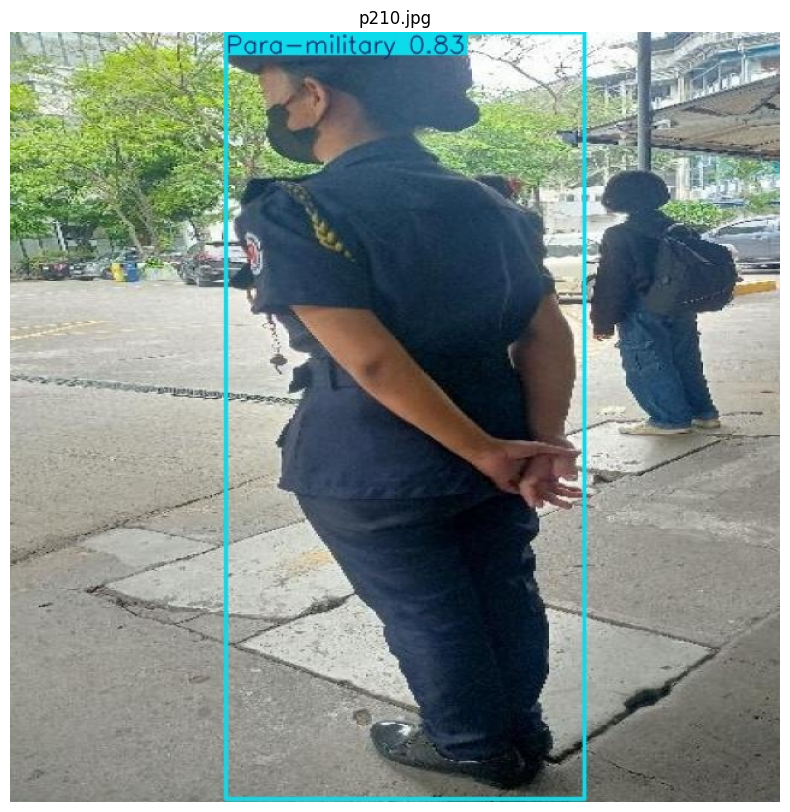

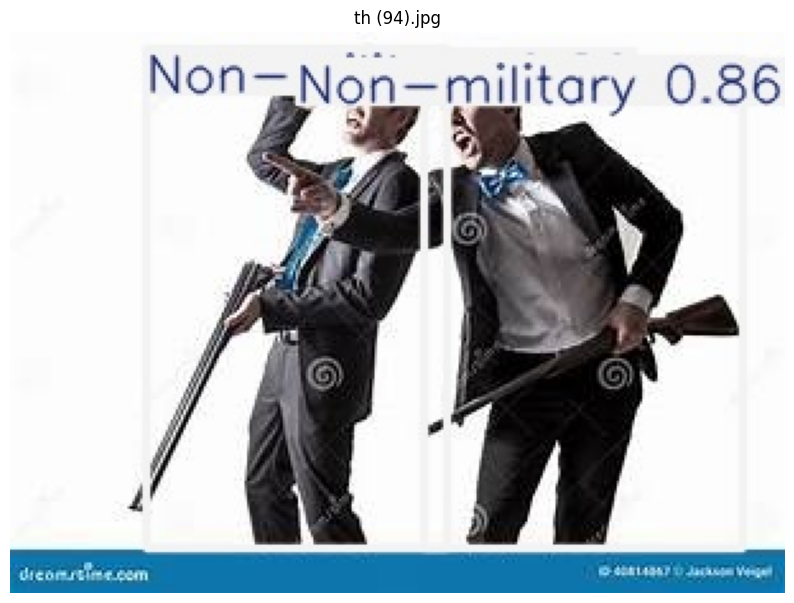

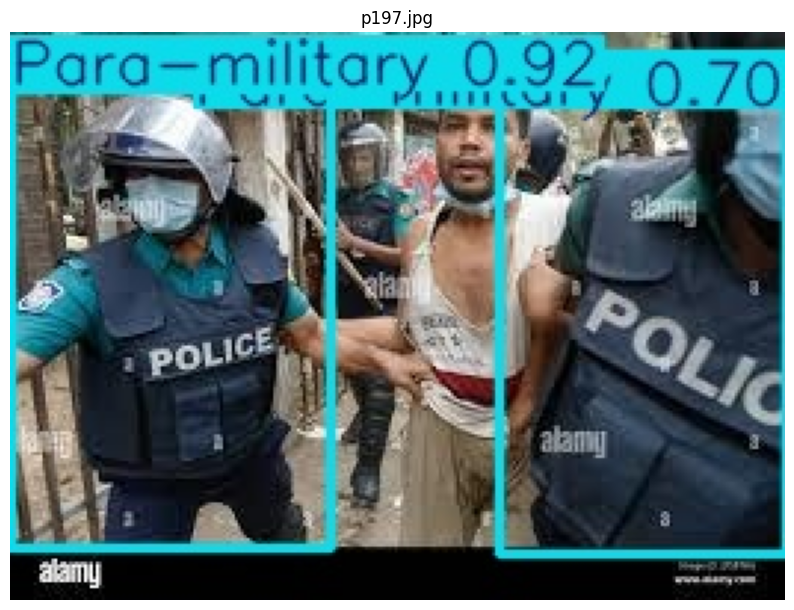

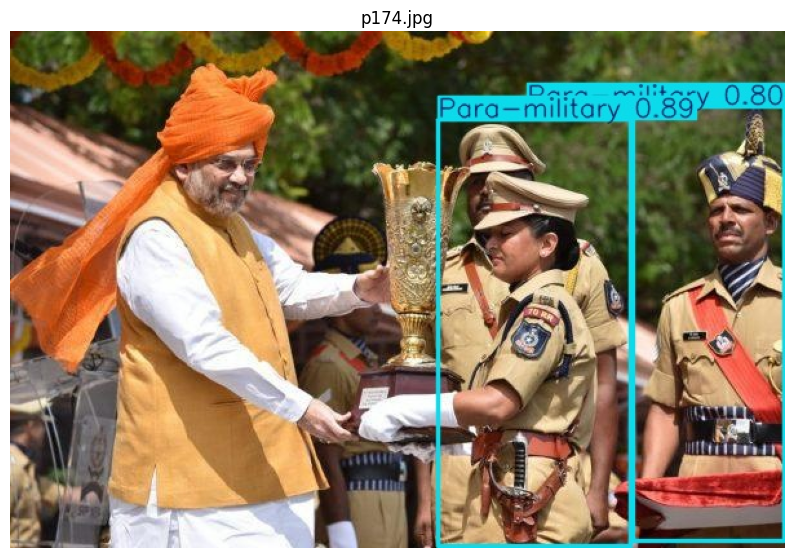

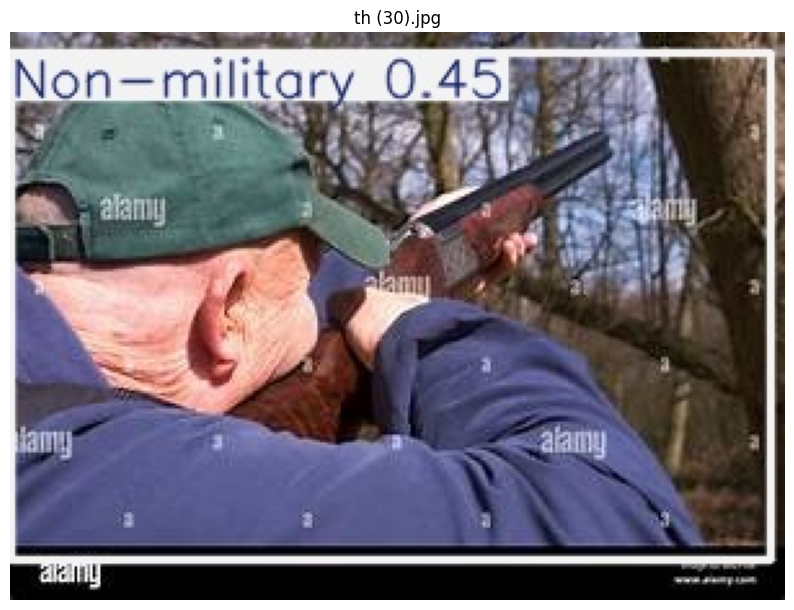

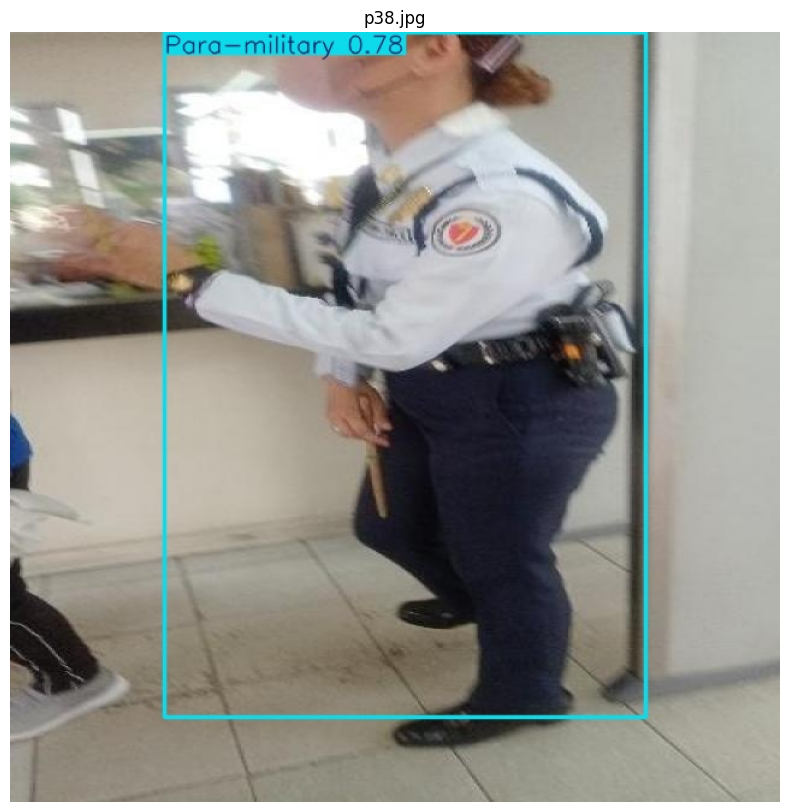

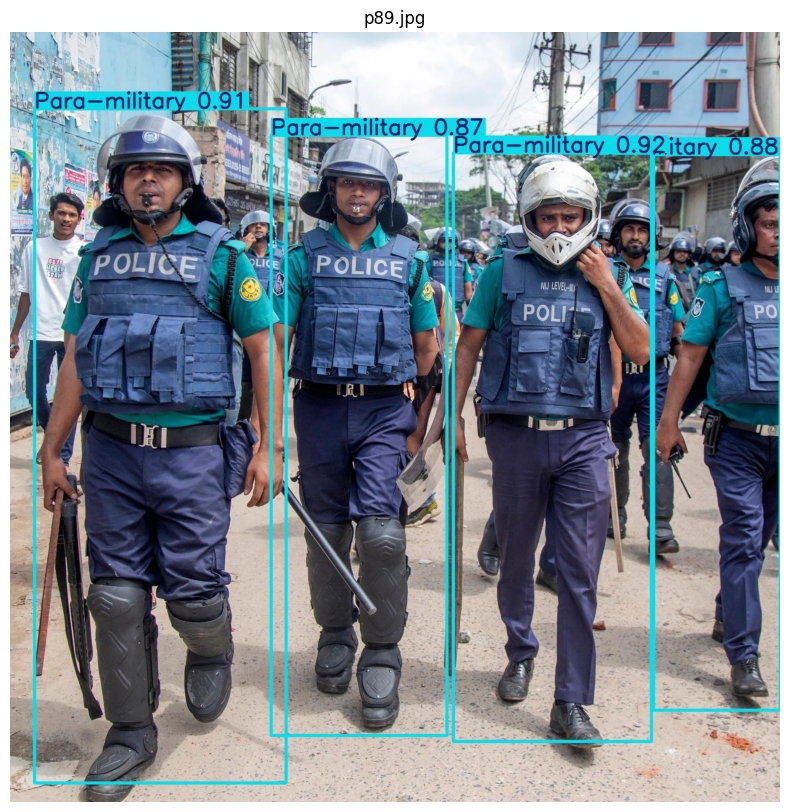

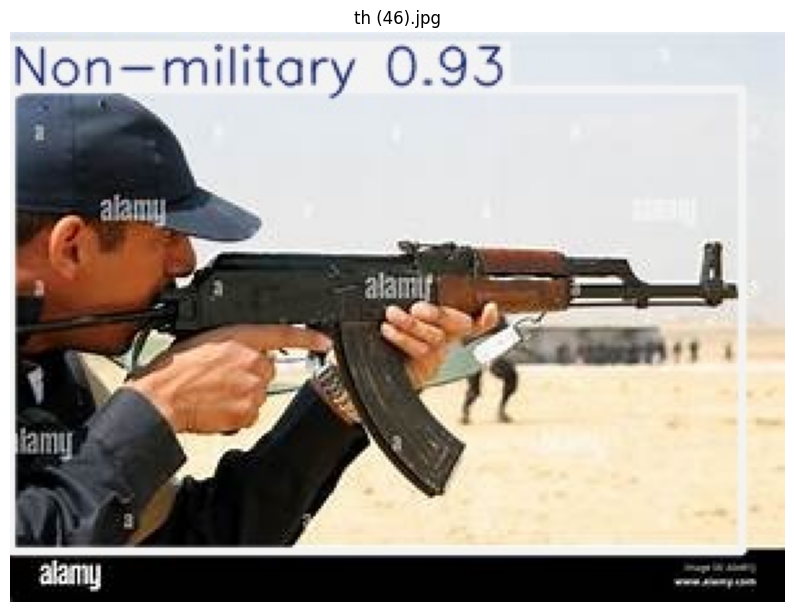

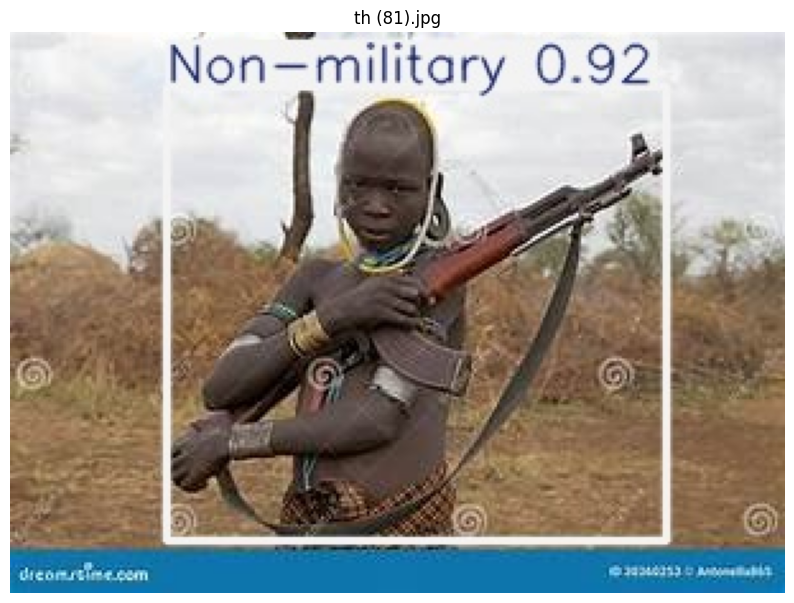

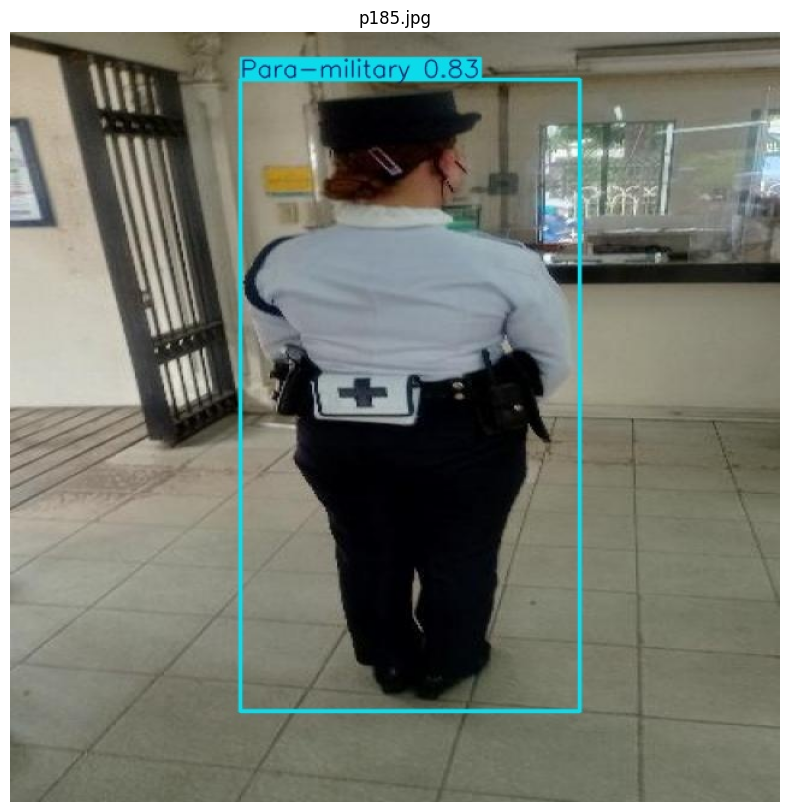

In [ ]:
import matplotlib.pyplot as plt
import cv2
import os

image_folder = 'runs/detect/predict3/'

image_files = [f for f in os.listdir(image_folder) if f.endswith(('.jpg', '.jpeg', '.webp'))]


for image_file in image_files:
    img_path = os.path.join(image_folder, image_file)
    img = cv2.imread(img_path)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

    plt.figure(figsize=(10, 10))
    plt.imshow(img)
    plt.title(image_file)
    plt.axis('off')
    plt.show()

# Tracking

In [ ]:
!git clone https://github.com/ultralytics/ultralytics
%cd ultralytics
!pip install -e .


fatal: destination path 'ultralytics' already exists and is not an empty directory.
/content/ultralytics
Obtaining file:///content/ultralytics
  Installing build dependencies ... done
  Checking if build backend supports build_editable ... done
  Getting requirements to build editable ... done
  Preparing editable metadata (pyproject.toml) ... done
  Building editable for ultralytics (pyproject.toml) ... done
  Created wheel for ultralytics: filename=ultralytics-8.3.58-0.editable-py3-none-any.whl size=22694 sha256=1020d6b09bb49fb8af173ce0c1ca652bf5778f38e900bad1c8f7a901aaba9c32
  Stored in directory: /tmp/pip-ephem-wheel-cache-te7wnj48/wheels/9a/cd/d5/95912172899f8ec640166ff6eef49156b1b00d6b2ade4a3cb1
Successfully built ultralytics
  Attempting uninstall: ultralytics
    Found existing installation: ultralytics 8.3.58
    Uninstalling ultralytics-8.3.58:
      Successfully uninstalled ultralytics-8.3.58


In [ ]:
from ultralytics import YOLO

# Load trained YOLOv8 model
model = YOLO('/content/drive/MyDrive/MLR/Yolo11Small_output/detect/train2/weights/best.pt')



In [ ]:
!pip install yt-dlp


     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 172.1/172.1 kB 7.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 3.2/3.2 MB 83.8 MB/s eta 0:00:00


In [ ]:
import os

# URL of the YouTube video
video_url = 'https://www.youtube.com/watch?v=ukQXyGhQDQ4'

# Use yt-dlp to download the video
!yt-dlp -f mp4 {video_url} -o '/content/downloaded_video1.mp4'


[youtube] Extracting URL: https://www.youtube.com/watch?v=ukQXyGhQDQ4
[youtube] ukQXyGhQDQ4: Downloading webpage
[youtube] ukQXyGhQDQ4: Downloading ios player API JSON
[youtube] ukQXyGhQDQ4: Downloading mweb player API JSON
[youtube] ukQXyGhQDQ4: Downloading player 095e6ee1
[youtube] ukQXyGhQDQ4: Downloading m3u8 information
[info] ukQXyGhQDQ4: Downloading 1 format(s): 18
[download] Destination: /content/downloaded_video1.mp4
[download] 100% of    1.01MiB in 00:00:00 at 1.64MiB/s


In [ ]:
!yolo track model='/content/drive/MyDrive/MLR/Yolo11Small_output/detect/train2/weights/best.pt' source='/content/downloaded_video1.mp4' save=True

requirements: Ultralytics requirement ['lap>=0.5.12'] not found, attempting AutoUpdate...
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.7/1.7 MB 54.9 MB/s eta 0:00:00

requirements: AutoUpdate success ✅ 2.5s, installed 1 package: ['lap>=0.5.12']
requirements: ⚠️ Restart runtime or rerun command for updates to take effect

Ultralytics 8.3.58 🚀 Python-3.10.12 torch-2.5.1+cu121 CUDA:0 (Tesla T4, 15102MiB)
YOLO11s summary (fused): 238 layers, 9,413,961 parameters, 0 gradients, 21.3 GFLOPs

video 1/1 (frame 1/355) /content/downloaded_video1.mp4: 384x640 5 Militarys, 52.1ms
video 1/1 (frame 2/355) /content/downloaded_video1.mp4: 384x640 5 Militarys, 10.9ms
video 1/1 (frame 3/355) /content/downloaded_video1.mp4: 384x640 5 Militarys, 10.8ms
video 1/1 (frame 4/355) /content/downloaded_video1.mp4: 384x640 5 Militarys, 10.8ms
video 1/1 (frame 5/355) /content/downloaded_video1.mp4: 384x640 5 Militarys, 10.8ms
video 1/1 (frame 6/355) /content/downloaded_video1.mp4: 384x640 5 Militarys, 10.9ms
video

In [ ]:
!ffmpeg -i "/content/ultralytics/runs/detect/track/downloaded_video1.avi" "/content/runs/downloaded_video1.mp4"

ffmpeg version 4.4.2-0ubuntu0.22.04.1 Copyright (c) 2000-2021 the FFmpeg developers
  built with gcc 11 (Ubuntu 11.2.0-19ubuntu1)
  configuration: --prefix=/usr --extra-version=0ubuntu0.22.04.1 --toolchain=hardened --libdir=/usr/lib/x86_64-linux-gnu --incdir=/usr/include/x86_64-linux-gnu --arch=amd64 --enable-gpl --disable-stripping --enable-gnutls --enable-ladspa --enable-libaom --enable-libass --enable-libbluray --enable-libbs2b --enable-libcaca --enable-libcdio --enable-libcodec2 --enable-libdav1d --enable-libflite --enable-libfontconfig --enable-libfreetype --enable-libfribidi --enable-libgme --enable-libgsm --enable-libjack --enable-libmp3lame --enable-libmysofa --enable-libopenjpeg --enable-libopenmpt --enable-libopus --enable-libpulse --enable-librabbitmq --enable-librubberband --enable-libshine --enable-libsnappy --enable-libsoxr --enable-libspeex --enable-libsrt --enable-libssh --enable-libtheora --enable-libtwolame --enable-libvidstab --enable-libvorbis --enable-libvpx --enab

In [ ]:
from IPython.display import Video

# Display the converted video
Video('/content/runs/downloaded_video1.mp4', embed=True)


In [ ]:
!yolo track model='/content/drive/MyDrive/MLR/Yolo11Small_output/detect/train2/weights/best.pt' \
            source='/content/downloaded_video1.mp4' \
            save=True \
            tracker='/content/ultralytics/ultralytics/cfg/trackers/bytetrack.yaml'


Ultralytics 8.3.58 🚀 Python-3.10.12 torch-2.5.1+cu121 CUDA:0 (Tesla T4, 15102MiB)
YOLO11s summary (fused): 238 layers, 9,413,961 parameters, 0 gradients, 21.3 GFLOPs

video 1/1 (frame 1/355) /content/downloaded_video1.mp4: 384x640 5 Militarys, 72.7ms
video 1/1 (frame 2/355) /content/downloaded_video1.mp4: 384x640 5 Militarys, 17.2ms
video 1/1 (frame 3/355) /content/downloaded_video1.mp4: 384x640 5 Militarys, 13.6ms
video 1/1 (frame 4/355) /content/downloaded_video1.mp4: 384x640 5 Militarys, 14.4ms
video 1/1 (frame 5/355) /content/downloaded_video1.mp4: 384x640 5 Militarys, 13.5ms
video 1/1 (frame 6/355) /content/downloaded_video1.mp4: 384x640 5 Militarys, 13.4ms
video 1/1 (frame 7/355) /content/downloaded_video1.mp4: 384x640 4 Militarys, 10.8ms
video 1/1 (frame 8/355) /content/downloaded_video1.mp4: 384x640 4 Militarys, 17.2ms
video 1/1 (frame 9/355) /content/downloaded_video1.mp4: 384x640 3 Militarys, 13.1ms
video 1/1 (frame 10/355) /content/downloaded_video1.mp4: 384x640 3 Militarys,

In [ ]:
!yolo track model='/content/drive/MyDrive/MLR/Yolo11Small_output/detect/train2/weights/best.pt' \
            source='/content/downloaded_video1.mp4' \
            save=True \
            tracker='/content/ultralytics/ultralytics/cfg/trackers/botsort.yaml'

Ultralytics 8.3.58 🚀 Python-3.10.12 torch-2.5.1+cu121 CUDA:0 (Tesla T4, 15102MiB)
YOLO11s summary (fused): 238 layers, 9,413,961 parameters, 0 gradients, 21.3 GFLOPs

video 1/1 (frame 1/355) /content/downloaded_video1.mp4: 384x640 5 Militarys, 50.5ms
video 1/1 (frame 2/355) /content/downloaded_video1.mp4: 384x640 5 Militarys, 10.9ms
video 1/1 (frame 3/355) /content/downloaded_video1.mp4: 384x640 5 Militarys, 10.8ms
video 1/1 (frame 4/355) /content/downloaded_video1.mp4: 384x640 5 Militarys, 10.8ms
video 1/1 (frame 5/355) /content/downloaded_video1.mp4: 384x640 5 Militarys, 10.8ms
video 1/1 (frame 6/355) /content/downloaded_video1.mp4: 384x640 5 Militarys, 10.8ms
video 1/1 (frame 7/355) /content/downloaded_video1.mp4: 384x640 4 Militarys, 10.8ms
video 1/1 (frame 8/355) /content/downloaded_video1.mp4: 384x640 4 Militarys, 10.8ms
video 1/1 (frame 9/355) /content/downloaded_video1.mp4: 384x640 3 Militarys, 10.8ms
video 1/1 (frame 10/355) /content/downloaded_video1.mp4: 384x640 4 Militarys,

In [ ]:
!pip install ultralytics
!pip install deep-sort-realtime


from ultralytics import YOLO
model = YOLO('/content/drive/MyDrive/MLR/Yolo11Small_output/detect/train2/weights/best.pt')
class_names = ["Artillery", "Missile", "Radar", "M. Rocket Launcher", "Soldier", "Tank", "Vehicle"]


import cv2
from deep_sort_realtime.deepsort_tracker import DeepSort
from ultralytics import YOLO
model = YOLO('/content/drive/MyDrive/MLR/Yolo11Small_output/detect/train2/weights/best.pt')
tracker = DeepSort(max_age=30, n_init=2, max_iou_distance=0.7)

class_names = [
    "Military",
  "Para-military",
  "Non-military"
]
input_video_path = '/content/downloaded_video1.mp4'
output_video_path = "/content/Tracking_Test_DeepSort_Tracked1.avi"

cap = cv2.VideoCapture(input_video_path)
frame_width = int(cap.get(cv2.CAP_PROP_FRAME_WIDTH))
frame_height = int(cap.get(cv2.CAP_PROP_FRAME_HEIGHT))
fps = int(cap.get(cv2.CAP_PROP_FPS))

fourcc = cv2.VideoWriter_fourcc(*"XVID")
out = cv2.VideoWriter(output_video_path, fourcc, fps, (frame_width, frame_height))

while cap.isOpened():
    ret, frame = cap.read()
    if not ret:
        break

    results = model.predict(source=frame, save=False, save_txt=False, conf=0.5)

    detections = []
    class_ids = []
    for result in results[0].boxes:
        # Convert (x1, y1, x2, y2) to (x, y, width, height)
        x1, y1, x2, y2 = result.xyxy[0].tolist()
        x, y = x1, y1
        width, height = x2 - x1, y2 - y1
        confidence = result.conf[0].item()
        class_id = int(result.cls[0].item())

        # Append detection in the format [(x, y, width, height), confidence, class_id]
        detections.append([(x, y, width, height), confidence, class_id])
        class_ids.append(class_id)

    tracked_objects = tracker.update_tracks(detections, frame=frame)

    for track in tracked_objects:
        if not track.is_confirmed():
            continue
        ltrb = track.to_ltrb()

        class_id = track.det_class
        class_name = class_names[class_id] if class_id < len(class_names) else "Unknown"

        cv2.rectangle(frame, (int(ltrb[0]), int(ltrb[1])), (int(ltrb[2]), int(ltrb[3])), (0, 255, 0), 2)
        cv2.putText(frame, class_name, (int(ltrb[0]), int(ltrb[1] - 10)),
                    cv2.FONT_HERSHEY_SIMPLEX, 0.6, (255, 255, 255), 2)


    out.write(frame)

cap.release()
out.release()
print("Tracking complete. Output saved to:", output_video_path)


In [ ]:
!ffmpeg -i "/content/Tracking_Test_DeepSort_Tracked.avi" "/content/runs/downloaded_video4.mp4"

ffmpeg version 4.4.2-0ubuntu0.22.04.1 Copyright (c) 2000-2021 the FFmpeg developers
  built with gcc 11 (Ubuntu 11.2.0-19ubuntu1)
  configuration: --prefix=/usr --extra-version=0ubuntu0.22.04.1 --toolchain=hardened --libdir=/usr/lib/x86_64-linux-gnu --incdir=/usr/include/x86_64-linux-gnu --arch=amd64 --enable-gpl --disable-stripping --enable-gnutls --enable-ladspa --enable-libaom --enable-libass --enable-libbluray --enable-libbs2b --enable-libcaca --enable-libcdio --enable-libcodec2 --enable-libdav1d --enable-libflite --enable-libfontconfig --enable-libfreetype --enable-libfribidi --enable-libgme --enable-libgsm --enable-libjack --enable-libmp3lame --enable-libmysofa --enable-libopenjpeg --enable-libopenmpt --enable-libopus --enable-libpulse --enable-librabbitmq --enable-librubberband --enable-libshine --enable-libsnappy --enable-libsoxr --enable-libspeex --enable-libsrt --enable-libssh --enable-libtheora --enable-libtwolame --enable-libvidstab --enable-libvorbis --enable-libvpx --enab

In [ ]:
from IPython.display import Video

# Display the converted video
Video('/content/runs/downloaded_video4.mp4', embed=True)

In [ ]:
from IPython.display import Video

# Display the converted video
Video('/content/runs/downloaded_video3.mp4', embed=True)

In [ ]:
from IPython.display import Video

# Display the converted video
Video('/content/runs/downloaded_video2.mp4', embed=True)